# Accident Severity Prediction
- This notebook is for Coursera Capstone porject to build an accident severity prediction model

In [17]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from pandas_profiling import ProfileReport

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
mpl.rcParams['figure.dpi']= 150

In [3]:
print('Hello Capstone Project Course!')

Hello Capstone Project Course!


## 1 Introduction

### 1.1 Problem and background discussion

Accidents in traffic lead to associated fatalities and economic losses every year worldwide and thus is an area of primary concern to society from loss prevention point of view. Modeling accident severity prediction and improving the model are critical to the effective performance of road traffic systems for improved safety. In accident severity modeling, the input vectors are the characteristics of the accident, such as driver behavior and attributes of vehicle, highway and environment characteristics while the output vector is the corresponding class of accident severity.

There are two main engineering approaches for dealing with traffic safety problems: the reactive approach and the proactive approach. The reactive approach, or retrofit approach, consists of making the necessary improvements to variable, for instance, existing hazardous sites in order to reduce collision frequency and severity at these sites. The proactive approach, on the other hand, includes a collision prevention approach, like, preventing a potential unsafe road conditions from occurring in the first place. We focus on proactive approach which involves prediction of accident severity and working backwards, the concerned entity implements appropriate remedial measures to improve road safety. By recognizing the key factors that influence accident severity, the solution may be of great utility to various Government Departments/Authorities like Police, R&B and Transport from public policy point of view. The results of analysis and modeling can be used by these Departments to take appropriate measures to reduce accident impact and thereby improve traffic safety. It is also useful to the Insurers in terms of reduced claims and better underwriting as well as rate making.

### 1.2 Data description

The Collisions dataset of Seattle city is adopoted for this project, which inculdes all types of collisions provided by SPD and recorded by Traffic Records from 2004 to present (https://data.seattle.gov/Land-Base/Collisions/9kas-rb8d). A snapshot of data is shown below

In [4]:
df = pd.read_csv('./data/Collisions.csv')
df.head()

D:\tool\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3058: DtypeWarning: Columns (35) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,X,Y,OBJECTID,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,LOCATION,...,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
0,1.268354e+06,265256.609668,1,1003,1003,3503158,Matched,Block,NaN,AURORA AVE N BETWEEN N 117TH PL AND N 125TH ST,...,Dry,Daylight,Y,NaN,NaN,45,Vehicle - Pedalcyclist,15057,0,N
1,1.259316e+06,202173.388163,2,56200,56200,1795087,Matched,Block,NaN,35TH AVE SW BETWEEN SW MORGAN ST AND SW HOLLY ST,...,Dry,Dark - Street Lights On,NaN,6015003.0,NaN,0,Vehicle going straight hits pedestrian,0,0,N
2,1.264342e+06,259613.000382,3,327037,328537,E979380,Matched,Intersection,37122.0,3RD AVE NW AND NW 100TH ST,...,Wet,Daylight,NaN,NaN,NaN,10,Entering at angle,0,0,N
3,1.279221e+06,222017.872023,4,327278,328778,E996362,Unmatched,Intersection,30602.0,M L KING JR WAY S AND S JACKSON ST,...,NaN,NaN,NaN,NaN,NaN,,NaN,0,0,N
4,1.262205e+06,242179.124204,5,1248,1248,3645424,Unmatched,Block,NaN,W EWING ST BETWEEN 6TH AVE W AND W EWING PL,...,NaN,NaN,NaN,NaN,NaN,,NaN,0,0,N


## 2 Methodology

### 2.1 Exploratory data analysis

pandas_profiling is used to create a quick summary of all the variables. We can quickly examinate each of them to identify 1) if there is any abnormal with the data and 2) which of them are not useful for developing the model and hence can be dropped to create a slimmer dataset.
- Target variable: <b>SEVERITYCODE</b> is our target variable. As shown in the below reports, most of the accidents are with serverity code equal to 1(Property Damage Only Collision) or 2(Injury Collision), only a very few of cases fall into the category 2b(Serious Injury Collision) and 3(Fatality Collision), making the dataset unbalance in terms of the target variable. Also there are 21,616 records have 0 or unknown severity code which we need to remove them before developing the model.

- ID variable: Some id variables do not provide much information for predicting the severity of the accident and hence can be dropped. Here we drop these variables: <b>REPORTNO, OBJECTID, COLDETKEY, INTKEY</b>. We keep the <b>INCKEY</b> as the unique identifier for the accidents.

- Missing value: Some variables are having high percentage of missing values and hence we may drop them as they don't provide enough information when we develop the model. Here we drop these variables: <b>EXCEPTRSNCODE, EXCEPTRSNDESC, INATTENTIONIND, PEDROWNOTGRNT, SDOTCOLNUM, SEGLANEKEY, CROSSWALKKEY, INJURIES, SERIOUSINJURIES, FATALITIES</b>. Note that <b>INJURIES, SERIOUSINJURIES, FATALITIES</b> are also have target leakage issue, so it will be wise to drop them from the dataset.

- Derived variable: Some variables are not appropriate to be directly used for modeling because there are too many distinct values, such as <b>X, Y, LOCATION, INCDATE and INCDTTM.</b> Here we derive the day of week from <b>INCDATE</b> and categorize <b>INCDTTM</b> into 4 groups 0:00\~5:59, 6:00\~11:59, 12:00\~17:59 and 18:00\~23:59. For the coordination X, Y and location, they could be useful variable since they contains the the geographic information about the incident. But more expert knowledge and techniques are required to apply to extract useful information and hence we leave them for now. 

In [5]:
ProfileReport(df)

In [76]:
# Derive the day of week (DOW)
df['INCDOW'] = pd.to_datetime(df.INCDATE).dt.dayofweek+1

# Derive the hour of day (HOD)
df['INCDH'] = pd.to_datetime(df.INCDTTM).dt.hour
df['INCDHOD'] = df['INCDH'].apply(lambda x: '0:00~5:59' if 0<=x<=5 else
                                            '6:00~11:59' if 6<=x<=11 else
                                            '12:00~17:59' if 12<=x<=17 else
                                            '18:00~23:59')

In [78]:
df_2 = df.query("SEVERITYCODE.notnull().values and SEVERITYCODE!='0'")
df_2 = df_2.drop(columns=['X','Y','LOCATION','SEVERITYDESC', 'REPORTNO', 'OBJECTID', 'COLDETKEY', 'INTKEY',
                'EXCEPTRSNCODE', 'EXCEPTRSNDESC', 'INATTENTIONIND', 
                'PEDROWNOTGRNT', 'SDOTCOLNUM', 'SEGLANEKEY', 'CROSSWALKKEY',
                'INJURIES', 'SERIOUSINJURIES', 'FATALITIES',
                'INCDH','INCDATE','INCDTTM'])

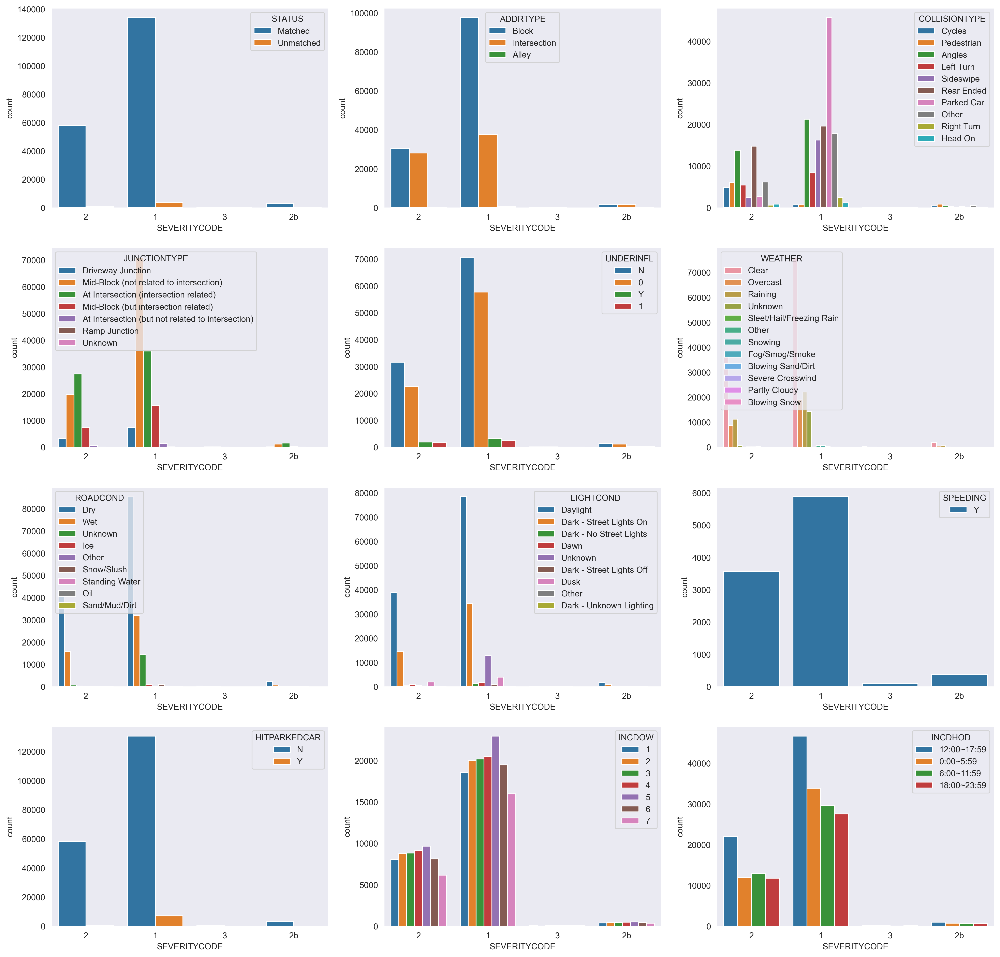

In [79]:
sns.set_style("dark")
fig = plt.figure(figsize=(20,20))
var_list = ['STATUS','ADDRTYPE','COLLISIONTYPE','JUNCTIONTYPE','UNDERINFL','WEATHER','ROADCOND',
            'LIGHTCOND','SPEEDING','HITPARKEDCAR','INCDOW','INCDHOD']

for i in range(len(var_list)):
    ax = fig.add_subplot(4, 3, i+1)
    var = var_list[i]
    sns.countplot(x='SEVERITYCODE', hue=var, data=df_2, ax = ax) 

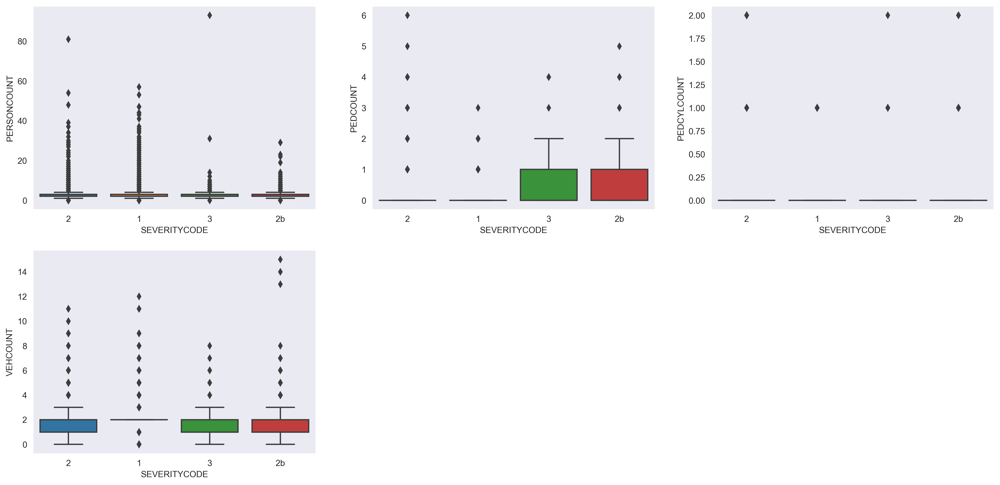

In [21]:
fig = plt.figure(figsize=(20,20))
var_list = ['PERSONCOUNT','PEDCOUNT','PEDCYLCOUNT','VEHCOUNT']

for i in range(len(var_list)):
    ax = fig.add_subplot(4, 3, i+1)
    var = var_list[i]
    sns.boxplot(x='SEVERITYCODE', y=var, data=df_2, ax = ax) 

In [23]:
df_2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 199909 entries, 0 to 221523
Data columns (total 22 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   INCKEY         199909 non-null  int64  
 1   STATUS         199909 non-null  object 
 2   ADDRTYPE       197978 non-null  object 
 3   SEVERITYCODE   199909 non-null  object 
 4   COLLISIONTYPE  195210 non-null  object 
 5   PERSONCOUNT    199909 non-null  int64  
 6   PEDCOUNT       199909 non-null  int64  
 7   PEDCYLCOUNT    199909 non-null  int64  
 8   VEHCOUNT       199909 non-null  int64  
 9   INCDATE        199909 non-null  object 
 10  INCDTTM        199909 non-null  object 
 11  JUNCTIONTYPE   193528 non-null  object 
 12  SDOT_COLCODE   199909 non-null  float64
 13  SDOT_COLDESC   199909 non-null  object 
 14  UNDERINFL      195230 non-null  object 
 15  WEATHER        195019 non-null  object 
 16  ROADCOND       195100 non-null  object 
 17  LIGHTCOND      194930 non-nul